# EDA

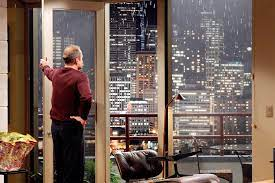

# Importing the Data Set

Using the following commands in DBeaver to get the data/merge tables:
```
SET SCHEMA 'eda';
SELECT k1.*, k2.date, k2.price
FROM king_county_house_details k1
INNER JOIN king_county_house_sales k2
ON k1.id = k2.house_id; 
```

The file is saved in data/king_county_house_details_sales.csv

In [21]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import PercentFormatter

# Library to visualize the missing the data
import missingno as msno

# Plot to identify poor neighborhoods
import altair as alt
import json
# Reprojecting geometrical data to adapt the coordinate system
import geopandas as gpd

# from vega_datasets import data as vega_data


Importing the merged data_set from a csv file. Which has already two joined tables to include price and it's date

In [22]:
df_kch = pd.read_csv('data/king_county_housing_details_a_sales.csv')

In [23]:
# Get info about the database: number of non null rows and data types
print(df_kch.info())
# Dimension of the dataset
print("Shape of the dataset:",np.shape(df_kch))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   bedrooms       21597 non-null  float64
 2   bathrooms      21597 non-null  float64
 3   sqft_living    21597 non-null  float64
 4   sqft_lot       21597 non-null  float64
 5   floors         21597 non-null  float64
 6   waterfront     19206 non-null  float64
 7   view           21534 non-null  float64
 8   condition      21597 non-null  int64  
 9   grade          21597 non-null  int64  
 10  sqft_above     21597 non-null  float64
 11  sqft_basement  21145 non-null  float64
 12  yr_built       21597 non-null  int64  
 13  yr_renovated   17749 non-null  float64
 14  zipcode        21597 non-null  int64  
 15  lat            21597 non-null  float64
 16  long           21597 non-null  float64
 17  sqft_living15  21597 non-null  float64
 18  sqft_l

Notes: 
- Waterfront, view, yr_renovated has some missing values
- Grade and Condition is in int
- Date is a string

In [24]:
df_kch.head(5)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,NaN,0.000,3,7,...,0.000,1955,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,...,400.000,1951,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,...,0.000,1933,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,...,910.000,1965,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,...,0.000,1987,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000


Converting the type of the date:

In [25]:
# converting the data type of date to date
df_kch['date'] = pd.to_datetime(df_kch['date'], format='%Y-%m-%d')

# Investigating simple statistics for columns & nan values & duplicates

In [26]:
# Basic statistics analysis of the columns:
print(df_kch.describe())

                  id  bedrooms  bathrooms  sqft_living    sqft_lot    floors  \
count      21597.000 21597.000  21597.000    21597.000   21597.000 21597.000   
mean  4580474287.771     3.373      2.116     2080.322   15099.409     1.494   
min      1000102.000     1.000      0.500      370.000     520.000     1.000   
25%   2123049175.000     3.000      1.750     1430.000    5040.000     1.000   
50%   3904930410.000     3.000      2.250     1910.000    7618.000     1.500   
75%   7308900490.000     4.000      2.500     2550.000   10685.000     2.000   
max   9900000190.000    33.000      8.000    13540.000 1651359.000     3.500   
std   2876735715.748     0.926      0.769      918.106   41412.637     0.540   

       waterfront      view  condition     grade  ...  sqft_basement  \
count   19206.000 21534.000  21597.000 21597.000  ...      21145.000   
mean        0.008     0.234      3.410     7.658  ...        291.857   
min         0.000     0.000      1.000     3.000  ...          

Compared to Berlin: 
 - the sqft of living is 5 times 
 - waterfront, view, yr_renovated, sqft-basement show uncammon values for 25%,50%,min .... 

In [27]:
print("Unique values for the waterfront:",df_kch["waterfront"].unique())
print("Unique values for the year renovated:",df_kch["yr_renovated"].unique())
print("Unique values for the condition:",df_kch["condition"].min(),"-",df_kch["condition"].max())
print("Unique values for the grade:",df_kch["grade"].min(),"-",df_kch["grade"].max())

Unique values for the waterfront: [nan  0.  1.]
Unique values for the year renovated: [    0. 19910.    nan 20020. 20100. 19920. 20130. 19940. 19780. 20050.
 20030. 19840. 19540. 20140. 20110. 19830. 19450. 19900. 19880. 19770.
 19810. 19950. 20000. 19990. 19980. 19700. 19890. 20040. 19860. 20070.
 19870. 20060. 19850. 20010. 19800. 19710. 19790. 19970. 19500. 19690.
 19480. 20090. 20150. 19740. 20080. 19680. 20120. 19630. 19510. 19620.
 19530. 19930. 19960. 19550. 19820. 19560. 19400. 19760. 19460. 19750.
 19640. 19730. 19570. 19590. 19600. 19670. 19650. 19340. 19720. 19440.
 19580.]
Unique values for the condition: 1 - 5
Unique values for the grade: 3 - 13


<Axes: >

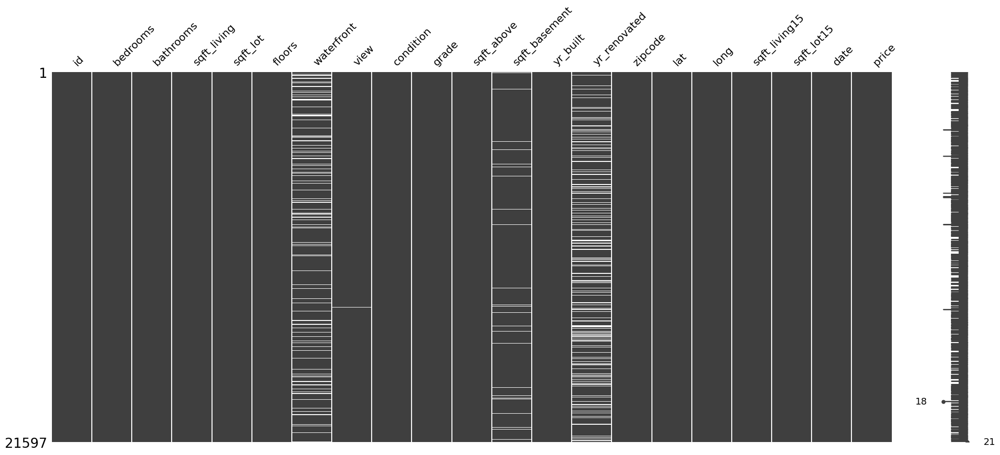

In [28]:
msno.matrix(df_kch)

Notes: waterfront,view, sqft_basement,yr_renovated has missing values

Basic statistical analysis of the columns:

In [29]:
# check how many duplicated rows exist in the data frame
df_kch.duplicated().value_counts()

False    21597
Name: count, dtype: int64

In [30]:
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# Investigating outliers

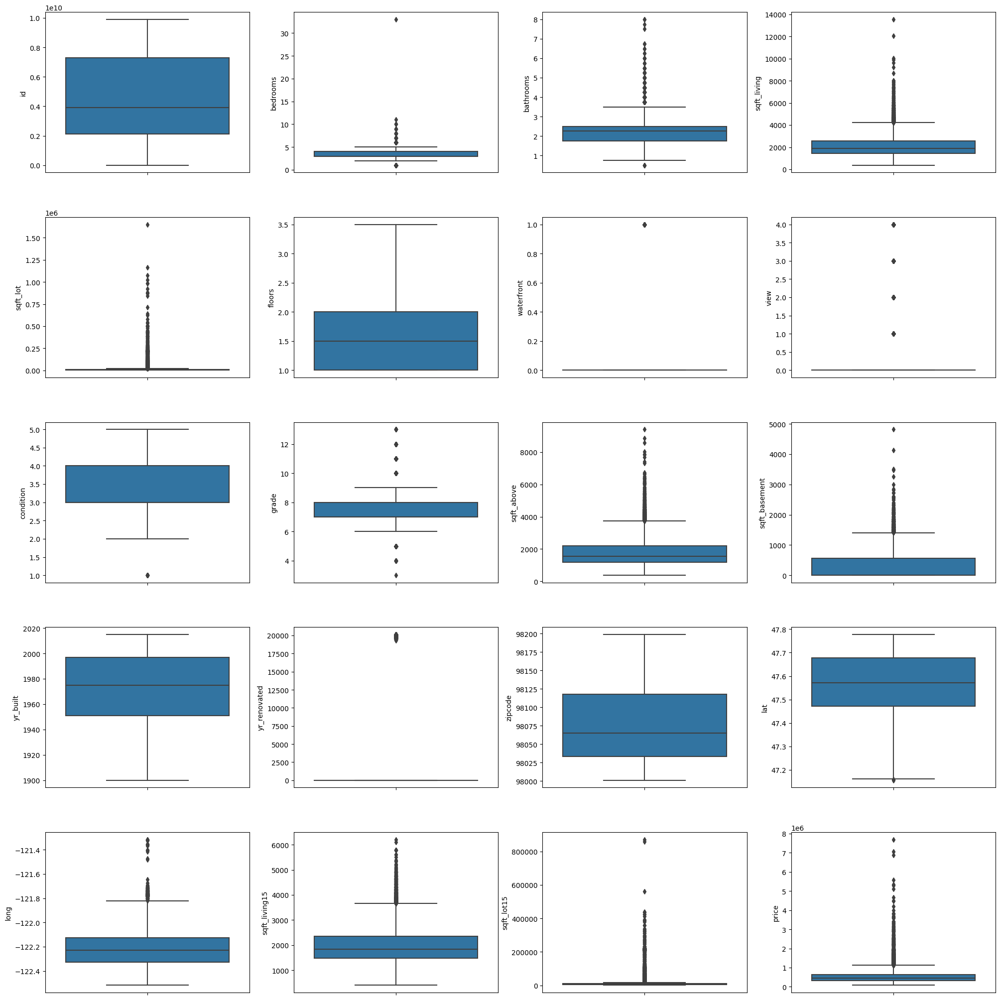

In [31]:
fig, axs = plt.subplots(ncols=4, nrows=5, figsize=(20,20))
index = 0
axs = axs.flatten()
for k,v in df_kch.items():
    if k!="date":
        sns.boxplot(y=k, data=df_kch, ax=axs[index])
        index += 1
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0)

In [32]:
# Percentage of outliers
for key, value in df_kch.items():
    # q1 and q3: lower and upper quartiles
    q1 = value.quantile(0.25)
    q3 = value.quantile(0.75)
    # interuartile range
    ir = q3 - q1
    # only outliers
    v_col = value[(value <= q1 - 1.5 * ir) | (value >= q3 + 1.5 * ir)]
    # percentage of outliers, but waterfront,view, sqft_basement,yr_renovated has still missing values
    perc = np.shape(v_col)[0] * 100.0 / np.shape(df_kch)[0]
    print("Column %s outliers = %.2f%%" % (key, perc))

Column id outliers = 0.00%
Column bedrooms outliers = 2.45%
Column bathrooms outliers = 2.60%
Column sqft_living outliers = 2.69%
Column sqft_lot outliers = 11.20%
Column floors outliers = 0.03%
Column waterfront outliers = 88.93%
Column view outliers = 99.71%
Column condition outliers = 0.13%
Column grade outliers = 8.82%
Column sqft_above outliers = 2.86%
Column sqft_basement outliers = 2.42%
Column yr_built outliers = 0.00%
Column yr_renovated outliers = 82.18%
Column zipcode outliers = 0.00%
Column lat outliers = 0.01%
Column long outliers = 1.18%
Column sqft_living15 outliers = 2.51%
Column sqft_lot15 outliers = 10.13%
Column date outliers = 0.00%
Column price outliers = 5.36%


# Customer Profile
Erin Robinson:
- Buyer, 
- Invest in poor neighborhood, 
- buying & selling, 
- costs back + little profit, 
- socially responsible  


Steps:
- Identifying poor neighborhoods
    - using the house grading system 1-13 of King County

In [33]:
df_kch.head(10)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,NaN,0.000,3,7,...,0.000,1955,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,...,400.000,1951,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,...,0.000,1933,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,...,910.000,1965,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,...,0.000,1987,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000
5,7237550310,4.000,4.500,5420.000,101930.000,1.000,0.000,0.000,3,11,...,1530.000,2001,0.000,98053,47.656,-122.005,4760.000,101930.000,2014-05-12,1230000.000
6,1321400060,3.000,2.250,1715.000,6819.000,2.000,0.000,0.000,3,7,...,NaN,1995,0.000,98003,47.310,-122.327,2238.000,6819.000,2014-06-27,257500.000
7,2008000270,3.000,1.500,1060.000,9711.000,1.000,0.000,NaN,3,7,...,0.000,1963,0.000,98198,47.410,-122.315,1650.000,9711.000,2015-01-15,291850.000
8,2414600126,3.000,1.000,1780.000,7470.000,1.000,0.000,0.000,3,7,...,730.000,1960,0.000,98146,47.512,-122.337,1780.000,8113.000,2015-04-15,229500.000
9,3793500160,3.000,2.500,1890.000,6560.000,2.000,0.000,0.000,3,7,...,0.000,2003,0.000,98038,47.368,-122.031,2390.000,7570.000,2015-03-12,323000.000


In [34]:
# GeoJson for the houses:
houses_geojson_data = {
    "type": "FeatureCollection",
    "features": [
        {
            "type": "Feature",
            "geometry": {"type": "Point", "coordinates": [row["long"], row["lat"]]},
            "properties": {"grade": row["grade"]}
        }
        for _, row in df_kch.iterrows()
    ]
}
houses_gdf = gpd.GeoDataFrame.from_features(houses_geojson_data)
# house_gdf
print(houses_gdf.columns)

Index(['geometry', 'grade'], dtype='object')


In [35]:
houses_geojson_data['features'][0]['geometry']['coordinates']

[-122.257, 47.5112]

In [36]:
houses_gdf.geometry[0].x
print(houses_gdf['geometry'].head())


0    POINT (-122.25700 47.51120)
1    POINT (-122.31900 47.72100)
2    POINT (-122.23300 47.73790)
3    POINT (-122.39300 47.52080)
4    POINT (-122.04500 47.61680)
Name: geometry, dtype: geometry


In [37]:
# Load the GeoJSON data using geopandas
# web page: https://gis-kingcounty.opendata.arcgis.com/datasets/kingcounty::metropolitan-king-county-council-kccdst-area/explore?location=47.521009%2C-121.704444%2C8.98
# following contains nice example: https://github.com/altair-viz/altair/issues/588


# importing this allows to access the properties for the plot
# with open("data/Metropolitan_King_County_Council___kccdst_area.geojson") as f:
with open("data/Cities_and_Unincorporated_King_County___city_kc_area.geojson") as f:
    geojson_data = json.load(f)
geoData = alt.Data(values=geojson_data['features'])

print(geoData)
# Create an Altair chart
map_chart = alt.Chart(geoData).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).encode(
    color=alt.value('lightgray'),  # Set a default color
    tooltip=[
        alt.Tooltip('properties.CITYNAME:O', title='City Name'),  # Access nested property
    ]
).project(
    type='identity', reflectY=True
).properties(
    width=500,
    height=500
)
# ).configure(background='transparent')



Data({
  values: [{'type': 'Feature', 'properties': {'OBJECTID': 1, 'JURIS': 'AL', 'CITYNAME': 'Algona', 'SHAPE_Length': 38144.66717876634, 'SHAPE_Area': 36411045.819109984}, 'geometry': {'type': 'Polygon', 'coordinates': [[[-122.2402199393646, 47.29352528605965], [-122.24040987595914, 47.293526542661596], [-122.24065350408834, 47.29352814532198], [-122.24088177327505, 47.29352963693205], [-122.24110746431336, 47.293531132780934], [-122.24111508260118, 47.293531175033365], [-122.24309393781097, 47.29354417348995], [-122.24310248342017, 47.29354423144093], [-122.24323866349269, 47.2935451140779], [-122.24330656824975, 47.29354555359131], [-122.24387903915667, 47.293549328368336], [-122.24442621563068, 47.29355291395291], [-122.24827350234985, 47.29357803885513], [-122.24992517155903, 47.293588786323504], [-122.25012183031461, 47.293586871319036], [-122.25254099867703, 47.29356922817107], [-122.25693893450573, 47.29353462554296], [-122.25778714368714, 47.29352804514432], [-122.2585257661

In [38]:
zoom = alt.selection_interval(bind='scales', encodings=['x', 'y'])

interactive_map_chart = map_chart.add_selection(zoom)

interactive_map_chart

alt.Chart(...)

In [45]:

# Putting the x,y data into lat and long column; helped with the visualization
houses_gdf['latitude'] = houses_gdf['geometry'].apply(lambda geom: geom.y)
houses_gdf['longitude'] = houses_gdf['geometry'].apply(lambda geom: geom.x)

bin_size = 0.01  # Adjust the bin size as needed, to have a grid
houses_gdf['bin_longitude'] = houses_gdf['longitude'].apply(lambda lon: round(lon / bin_size) * bin_size)
houses_gdf['bin_latitude'] = houses_gdf['latitude'].apply(lambda lat: round(lat / bin_size) * bin_size)

# Specifying the ranges to match the scale of the maps
x_range = [houses_gdf['longitude'].min(), houses_gdf['longitude'].max()]
y_range = [houses_gdf['latitude'].min(), houses_gdf['latitude'].max()]
# print("x&y range: ", x_range, y_range)
houses_gdf_subset = houses_gdf.head(1000)

houses_chart = alt.Chart(houses_gdf).mark_circle(
    color='red',
    size=100
).encode(
    longitude=alt.Longitude('longitude:Q'),
    latitude=alt.Latitude('latitude:Q'),
    tooltip=[
        alt.Tooltip('grade:O', title='Grade')
    ],
    color=alt.Color('grade:Q', scale=alt.Scale(scheme='viridis',domain=[0, 13]),legend=alt.Legend(direction='vertical',orient='right', title='Average Grade',titleOrient='top',cornerRadius=0.5)),

)


# print(houses_gdf_subset.head(10))

grid_chart = alt.Chart(houses_gdf).transform_aggregate(
    count='count()',
    average_grade='average(grade)',
    groupby=['bin_longitude', 'bin_latitude']
).mark_circle(opacity=0.7).encode(
    longitude='bin_longitude:Q',
    latitude='bin_latitude:Q',
    size=alt.Size('count:Q', title='Count', scale=alt.Scale(range=[1, 10])),
    color=alt.Color('average_grade:Q', scale=alt.Scale(scheme='viridis', domain=[0, 13])),
    tooltip=[
        alt.Tooltip('average_grade:Q', title='Average Grade'),
        alt.Tooltip('count:Q', title='Count')
    ]
).properties(
    width=500,
    height=500
)

# houses_gdff = gpd.GeoDataFrame(
#     houses_gdf,
#     geometry=gpd.points_from_xy(houses_gdf.longitude, houses_gdf.latitude),
#     crs=gdf.crs
# )

# Create a grid-based aggregation for houses
# grid_chart = alt.Chart(houses_gdf_subset).mark_rect(opacity=0.7).encode(
#     x=alt.X('longitude:Q', bin=alt.Bin(step=0.01),axis=None),
#     y=alt.Y('latitude:Q', bin=alt.Bin(step=0.01),axis=None),
#     # color=alt.Color('average(grade):Q', scale=alt.Scale(scheme='viridis',domain=[0, 13]),legend=alt.Legend(direction='vertical',orient='right', title='Average Grade',titleOrient='top',cornerRadius=0.5)),
# )
import altair as alt
import altair_viewer
# alt.renderers.enable('altair_viewer')
# altair_viewer.show(chart)
# alt.renderers.enable('altair_viewer')
# alt.renderers.enable('altair_viewer', inline=True)

# alt.renderers.enable('mimetype')
alt.data_transformers.disable_max_rows()
altair_viewer.show(grid_chart)

# grid_chart.interactive()
# houses_chart

RuntimeError: Internal: _stream is not defined.

In [ ]:
# Combine the map and house charts
alt.data_transformers.disable_max_rows()

combined_chart = map_chart + grid_chart
# combined_chart = map_chart + houses_chart

# Render the combined chart
combined_chart.add_selection(
    bind
).interactive()

alt.LayerChart(...)